In [1]:
import scanpy as sc
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import os

In [2]:
path='../../figures/6.Imputation/GenePrediction/'

In [3]:
adatasub=sc.read(path+'DataPreparation/newData/ms_brain_multisection1_subset.h5ad')

In [4]:
saving_path=r'../../data/processed_adata/'
adata=sc.read('../../data/processed_adata/adata_multisection_nuclei_3rep_withHM_withclusters_withNMP.h5ad')
#adata=adata.layers['raw']
adata.X=adata.layers['raw']
adata=adata[adata.obs['replicate']=='1']

/home/sergio/anaconda3/envs/xb/lib/python3.7/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [5]:
adatasub.obs['cell_id']

90832      90833
158997    158998
635          636
61504      61505
84824      84825
           ...  
32936      32937
120787    120788
80981      80982
158489    158490
54619      54620
Name: cell_id, Length: 1620, dtype: int64

In [6]:
adata[adata.obs['cell_id'].isin(adatasub.obs['cell_id'])]

View of AnnData object with n_obs × n_vars = 1436 × 248
    obs: 'cell_id', 'x_centroid', 'y_centroid', 'transcript_counts', 'control_probe_counts', 'control_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'replicate', 'n_counts', 'n_genes', 'leiden_2_2', 'leiden_1_4', 'leiden_0_6', 'X', 'Y', 'X_umap', 'Y_umap', 'dataset_source', 'nucleus_prop', 'Class', 'neighborhood_diversity', 'neighborhood_density', 'negative_purity_ratio', 'negative_purity_values', 'negative_purity_potential'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'Class_colors', 'dendrogram_leiden_1_4', 'hvg', 'leiden', 'leiden_1_4_colors', 'leiden_2_2_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups', 'replicate_colors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'raw'
    obsp: 'connectivities', 'distances'

In [7]:
locations=pd.read_csv(path+'DataPreparation/newData/Locations.txt',sep='\t')
count=pd.read_csv(path+'DataPreparation/newData/Insitu_count.txt',sep='\t')
count.columns=[c.lower() for c in count.columns]

# read predictions

In [8]:
files=os.listdir(path+'SpatialBenchmarking/XeniumResults')

In [9]:
imputation_files=[f for f in files if '_impute' in f]

In [10]:
self=imputation_files[0]

In [11]:
# per cell score

In [12]:
allsc=[]
for self in imputation_files:
    preds=pd.read_csv(path+'SpatialBenchmarking/XeniumResults/'+self,index_col=0)
    preds.columns=[c.lower() for c in preds.columns]
    preds=preds.loc[:,count.columns]
    #diff=abs(preds-count)
    #diff.index=adatasub.obs['cell_id']
    #resu=pd.DataFrame(np.mean(diff,axis=1),columns=[self.strip('_impute.csv')])
    #resu=resu.div(list(np.sum(count,axis=1)),axis=0)
    aggcor=[]
    for ind in preds.index:
        aggcor.append(np.corrcoef(preds.loc[ind,:],count.loc[ind,:])[0,1])
    resu=pd.DataFrame(aggcor,index=preds.index,columns=[self.strip('_impute.csv')])
    allsc.append(resu)
predict_score=pd.concat(allsc,axis=1)
predict_score['MEAN']=predict_score.mean(axis=1)

In [13]:
psm=predict_score.sort_values(by='MEAN')

Text(0, 0.5, 'Mean prediction error')

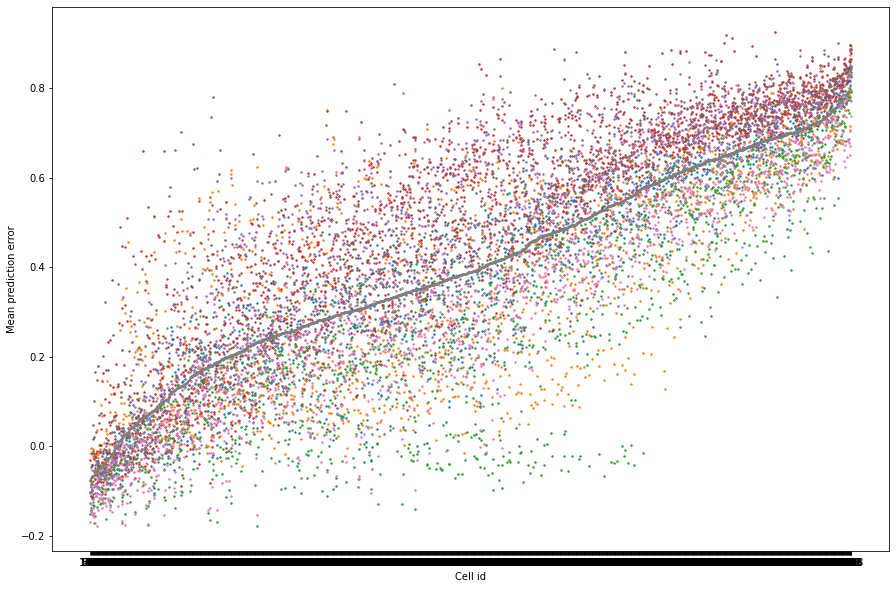

In [14]:
plt.figure(figsize=(15,10))
for c in psm.columns:
    plt.scatter(psm.index.astype(str),psm[c],s=2)
plt.xlabel('Cell id')
plt.ylabel('Mean prediction error')

In [15]:
pred_error_dict=dict(zip(psm.index,psm['MEAN']))

In [16]:
adata.obs['imputation_error']=adata.obs['cell_id'].map(pred_error_dict)

/home/sergio/anaconda3/envs/xb/lib/python3.7/site-packages/ipykernel_launcher.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  """Entry point for launching an IPython kernel.


In [17]:
adatapred=adata[~adata.obs['imputation_error'].isna()]

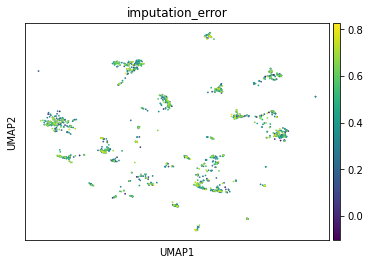

In [18]:
sc.pl.umap(adatapred,color='imputation_error',s=12)

In [19]:
ordi=adatapred.obs.groupby('Class').mean().sort_values(by='imputation_error').index

<Figure size 400x400 with 0 Axes>

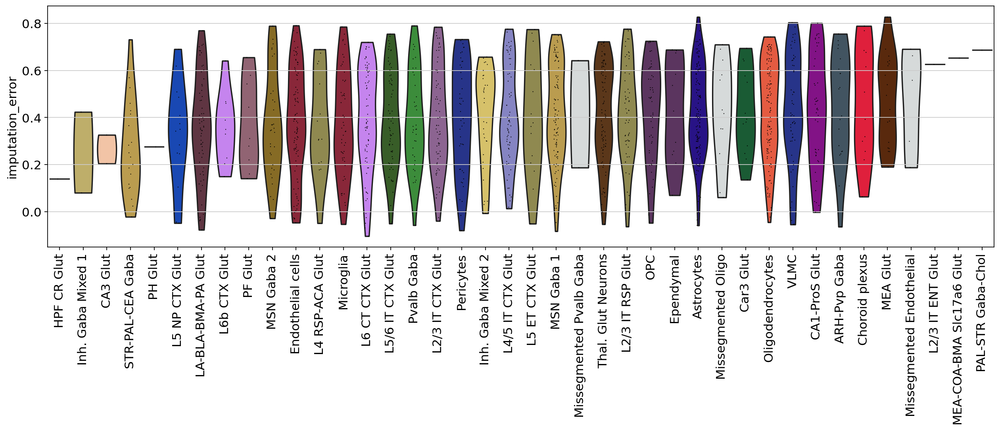

In [152]:
plt.figure(figsize=(5,5))
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
sc.set_figure_params(scanpy=True, dpi=80, dpi_save=150, frameon=True, vector_friendly=True, fontsize=14, figsize=(15,5), color_map=None, format='pdf', facecolor=None, transparent=False, ipython_format='png2x')
sc.pl.violin(adatapred,'imputation_error',groupby='Class',swap_axes=True,rotation=90,order=ordi,show=False)
plt.savefig('../../figures/6.Imputation/cell_error_by_celltype.pdf')

Correlation is :-0.006657655498526109


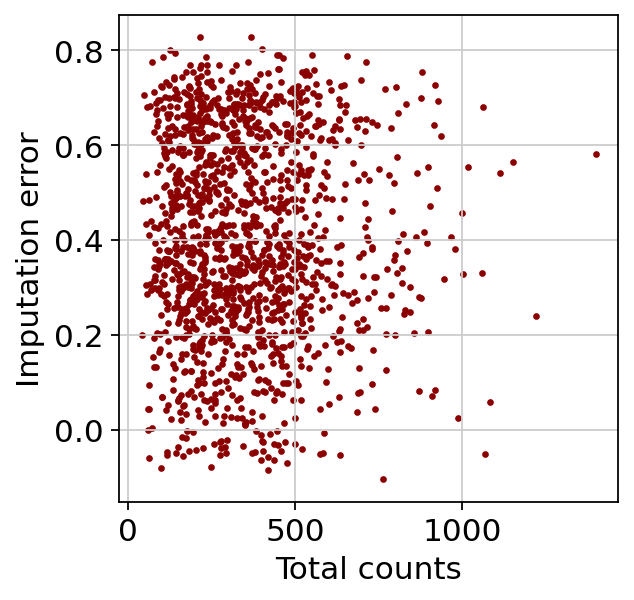

In [160]:
plt.figure(figsize=(4,4))
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
plt.scatter(adatapred.obs['transcript_counts'],adatapred.obs['imputation_error'],s=4,color='darkred')
plt.xlabel('Total counts')
plt.ylabel('Imputation error')
plt.grid('off')
print('Correlation is :'+str(np.corrcoef(adatapred.obs['transcript_counts'],adatapred.obs['imputation_error'])[0,1]))
plt.savefig('../../figures/6.Imputation/cell_error_transcript_countsxcell.pdf')

Correlation is :0.03002807316200365


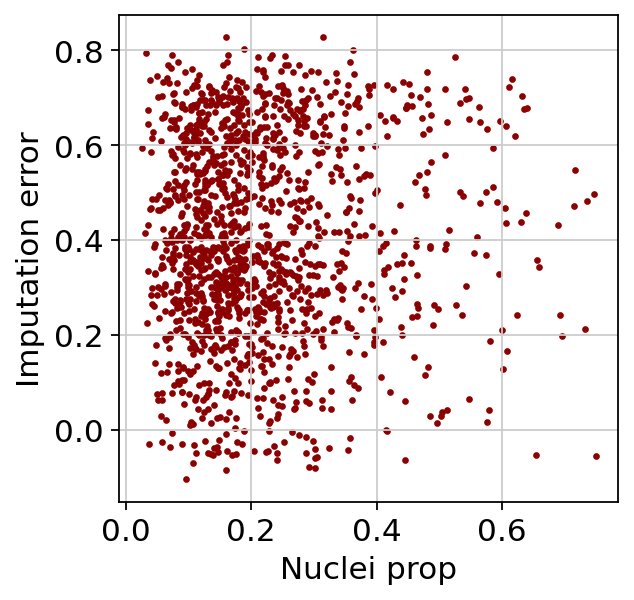

In [161]:
plt.figure(figsize=(4,4))
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
plt.scatter(adatapred.obs['nucleus_prop'],adatapred.obs['imputation_error'],s=4,color='darkred')
plt.xlabel('Nuclei prop')
plt.ylabel('Imputation error')
plt.grid('off')
print('Correlation is :'+str(np.corrcoef(adatapred.obs['nucleus_prop'],adatapred.obs['imputation_error'])[0,1]))
plt.savefig('../../figures/6.Imputation/cell_error_nucleus_prop.pdf')

Correlation is :0.028498887486236215


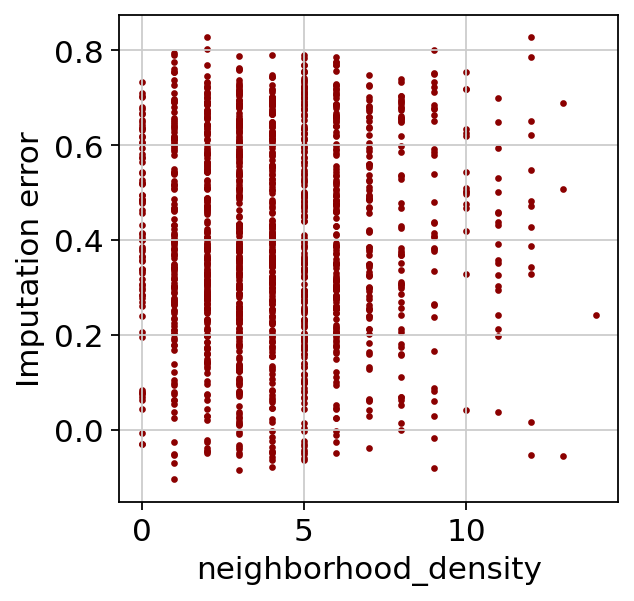

In [167]:
plt.figure(figsize=(4,4))
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
plt.scatter(adatapred.obs['neighborhood_density'],adatapred.obs['imputation_error'],s=4,color='darkred')
plt.xlabel('neighborhood_density')
plt.ylabel('Imputation error')
plt.grid('off')
print('Correlation is :'+str(np.corrcoef(adatapred.obs['neighborhood_density'],adatapred.obs['imputation_error'])[0,1]))
plt.savefig('../../figures/6.Imputation/cell_error_neighborhood_density.pdf')

Correlation is :0.0032479934601207486


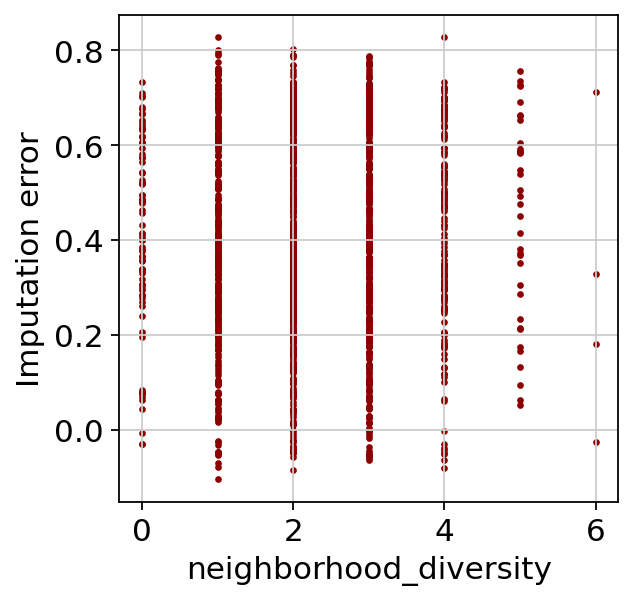

In [166]:
plt.figure(figsize=(4,4))
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
plt.scatter(adatapred.obs['neighborhood_diversity'],adatapred.obs['imputation_error'],s=4,color='darkred')
plt.xlabel('neighborhood_diversity')
plt.ylabel('Imputation error')
plt.grid('off')
print('Correlation is :'+str(np.corrcoef(adatapred.obs['neighborhood_diversity'],adatapred.obs['imputation_error'])[0,1]))
plt.savefig('../../figures/6.Imputation/cell_error_neighborhood_diversity.pdf')

/home/sergio/anaconda3/envs/xb/lib/python3.7/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


Correlation is :0.03002807316200365


/home/sergio/anaconda3/envs/xb/lib/python3.7/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


Correlation is :0.03002807316200365


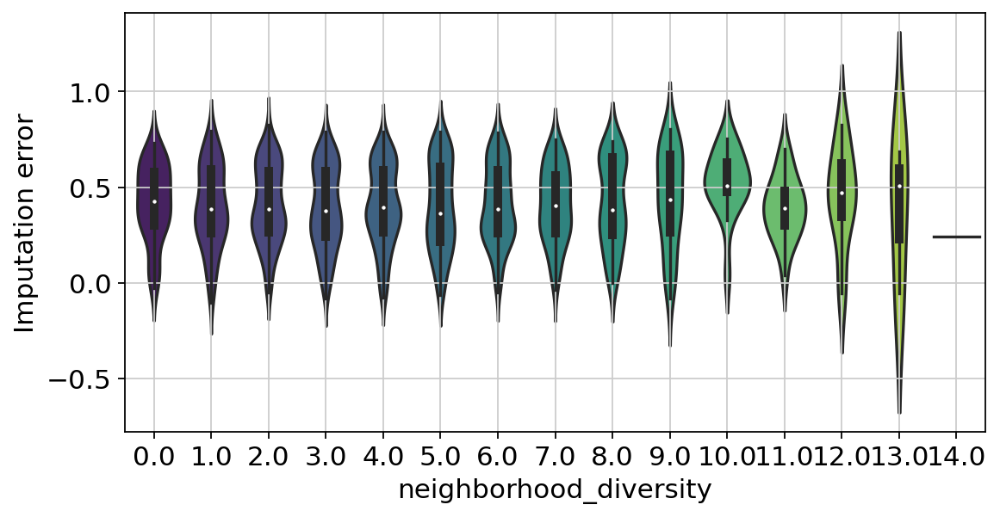

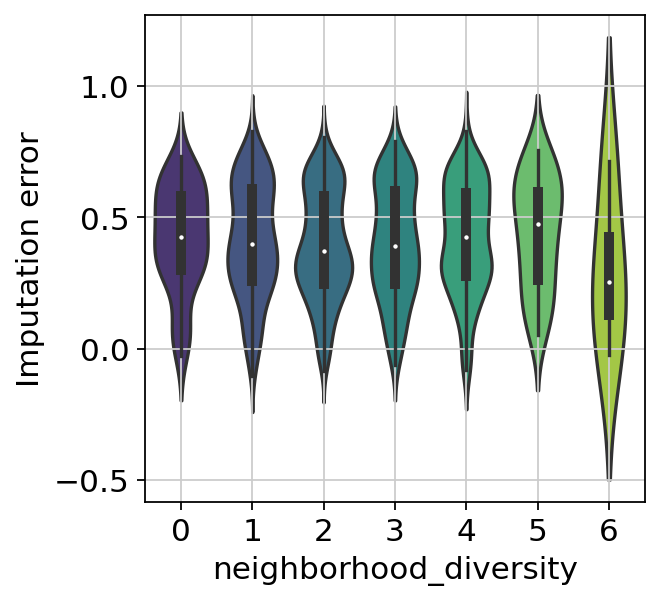

In [172]:
plt.figure(figsize=(8,4))
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
sns.violinplot(adatapred.obs['neighborhood_density'],adatapred.obs['imputation_error'],s=4,palette='viridis')
plt.xlabel('neighborhood_diversity')
plt.ylabel('Imputation error')
plt.grid('off')
print('Correlation is :'+str(np.corrcoef(adatapred.obs['nucleus_prop'],adatapred.obs['imputation_error'])[0,1]))
plt.savefig('../../figures/6.Imputation/cell_error_neighborhood_density_violin.pdf')

plt.figure(figsize=(4,4))
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
sns.violinplot(adatapred.obs['neighborhood_diversity'],adatapred.obs['imputation_error'],s=4,palette='viridis')
plt.xlabel('neighborhood_diversity')
plt.ylabel('Imputation error')
plt.grid('off')
print('Correlation is :'+str(np.corrcoef(adatapred.obs['nucleus_prop'],adatapred.obs['imputation_error'])[0,1]))
plt.savefig('../../figures/6.Imputation/cell_error_neighborhood_diversity_violin.pdf')

Correlation is :-0.008381978470425822


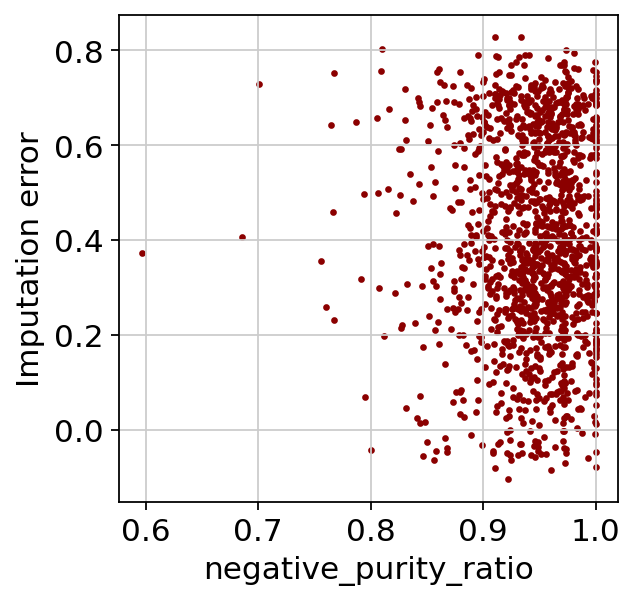

In [165]:
plt.figure(figsize=(4,4))
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
plt.scatter(adatapred.obs['negative_purity_ratio'],adatapred.obs['imputation_error'],s=4,color='darkred')
plt.xlabel('negative_purity_ratio')
plt.ylabel('Imputation error')
plt.grid('off')
print('Correlation is :'+str(np.corrcoef(adatapred.obs['negative_purity_ratio'],adatapred.obs['imputation_error'])[0,1]))
plt.savefig('../../figures/6.Imputation/cell_error_negative_purity_ratio.pdf')

# Plot imputed expression

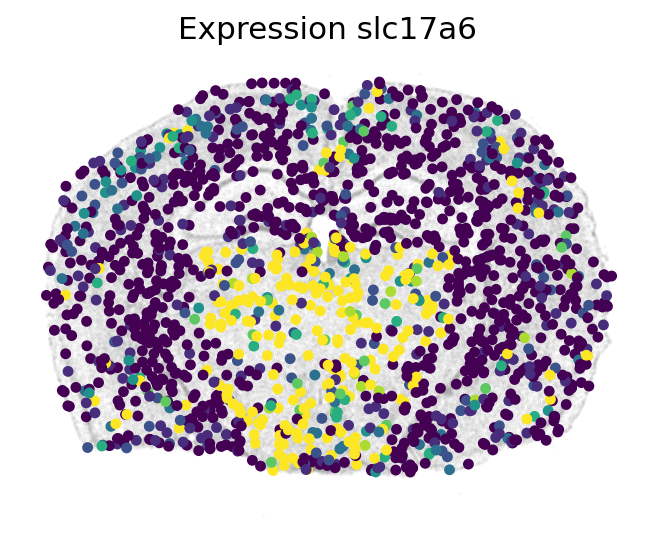

In [264]:
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
plt.figure(figsize=(5,4))
plt.scatter(adata.obs['x_centroid'],adata.obs['y_centroid'],c='grey',s=0.0007)
plt.scatter(x=locations.X,y=locations.Y,c=count['slc17a6'],s=15,vmax=8)
plt.axis('off')
plt.title('Expression'+' slc17a6')
plt.savefig('../../figures/6.Imputation/imputed_expression_map_expression_slc17a6.png',dpi=400)

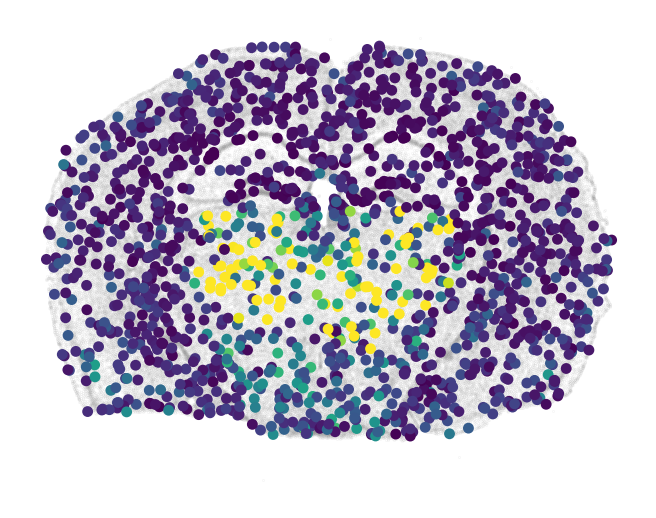

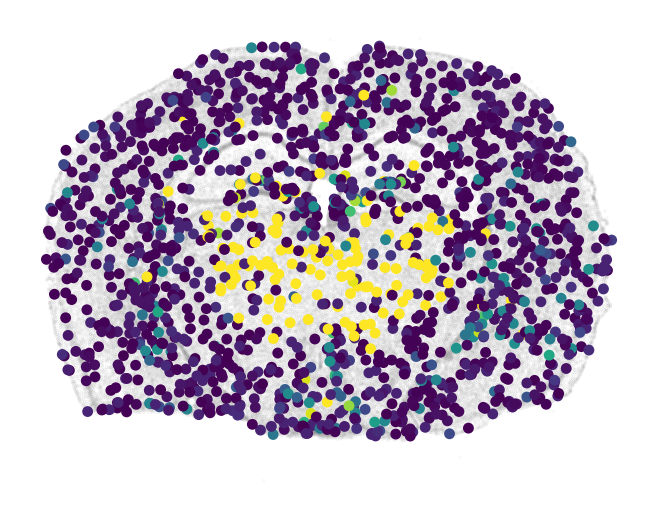

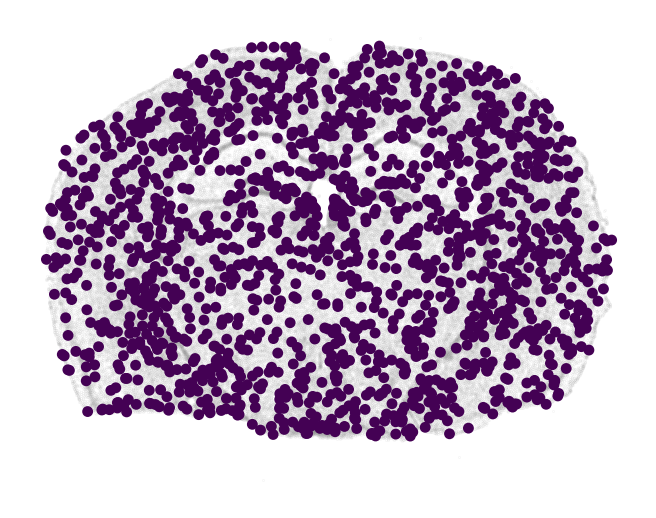

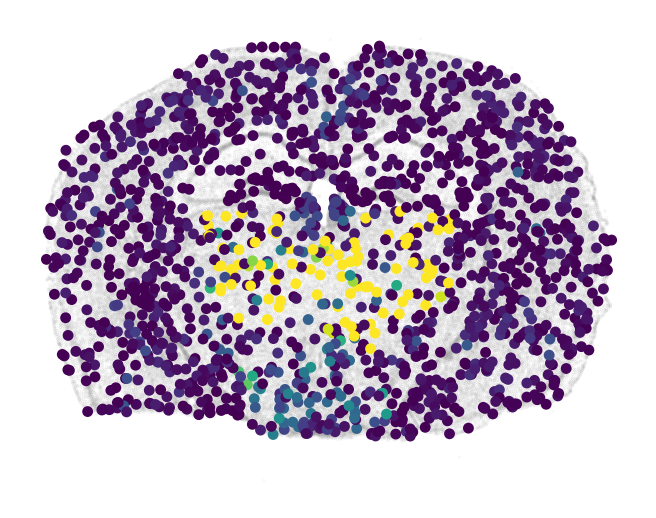

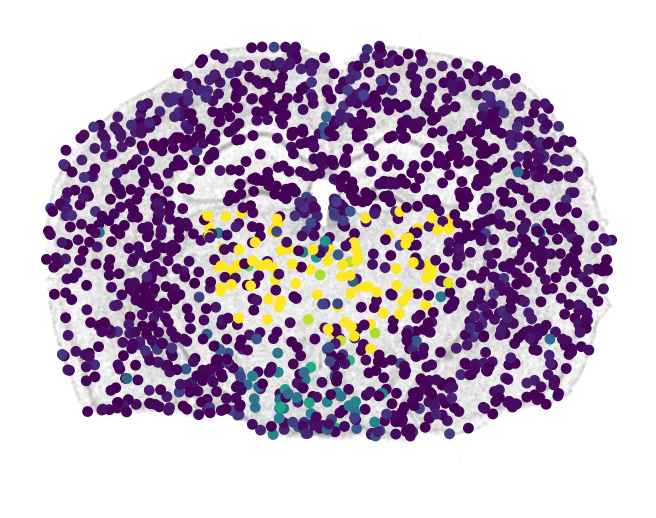

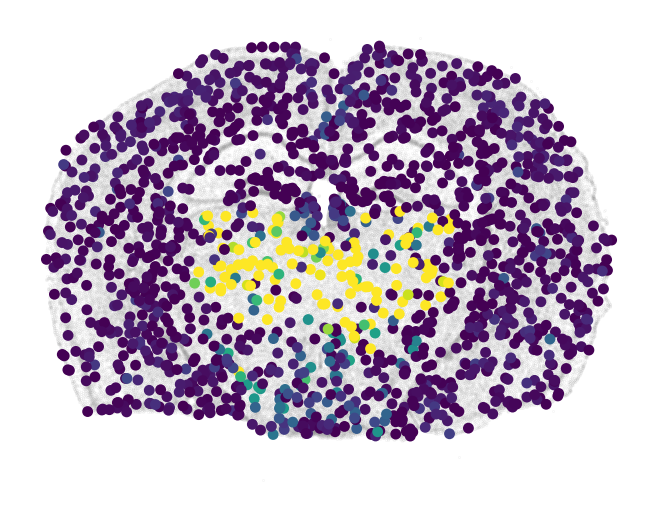

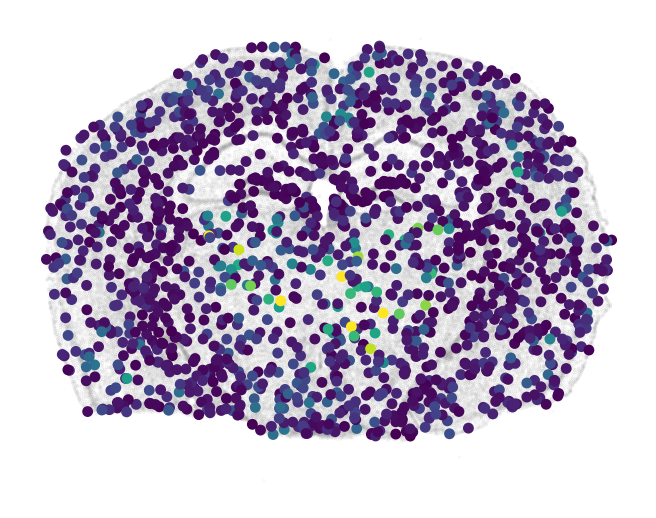

In [263]:
allsc=[]
for self in imputation_files:
    preds=pd.read_csv(path+'SpatialBenchmarking/XeniumResults/'+self,index_col=0)
    preds.columns=[c.lower() for c in preds.columns]
    preds=preds.loc[:,count.columns]
    import matplotlib
    matplotlib.rcParams['pdf.fonttype'] = 42
    matplotlib.rcParams['ps.fonttype'] = 42
    plt.figure(figsize=(5,4))
    plt.scatter(adata.obs['x_centroid'],adata.obs['y_centroid'],c='grey',s=0.0007)
    plt.scatter(x=locations.X,y=locations.Y,c=preds['slc17a6'],s=15,vmax=8)
    plt.axis('off')
    #plt.title(self.strip('_impute.csv')+' slc17a6')
    plt.savefig('../../figures/6.Imputation/imputed_expression_map'+self.strip('_impute.csv')+' slc17a6.png',dpi=400)
    plt.show()
    #diff=abs(preds-count)
    #diff.index=adatasub.obs['cell_id']
    #resu=pd.DataFrame(np.mean(diff,axis=1),columns=[self.strip('_impute.csv')])
    #resu=resu.div(list(np.sum(count,axis=1)),axis=0)
    aggcor=[]
    for ind in preds.index:
        aggcor.append(np.corrcoef(preds.loc[ind,:],count.loc[ind,:])[0,1])
    resu=pd.DataFrame(aggcor,index=preds.index,columns=[self.strip('_impute.csv')])
    allsc.append(resu)
predict_score=pd.concat(allsc,axis=1)
predict_score['MEAN']=predict_score.mean(axis=1)

In [224]:
adata.obs['x_centroid']

AnnData object with n_obs × n_vars = 142991 × 248
    obs: 'cell_id', 'x_centroid', 'y_centroid', 'transcript_counts', 'control_probe_counts', 'control_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'replicate', 'n_counts', 'n_genes', 'leiden_2_2', 'leiden_1_4', 'leiden_0_6', 'X', 'Y', 'X_umap', 'Y_umap', 'dataset_source', 'nucleus_prop', 'Class', 'neighborhood_diversity', 'neighborhood_density', 'negative_purity_ratio', 'negative_purity_values', 'negative_purity_potential', 'imputation_error'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'Class_colors', 'dendrogram_leiden_1_4', 'hvg', 'leiden', 'leiden_1_4_colors', 'leiden_2_2_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups', 'replicate_colors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'raw'
    obsp: 'connectivities', 'distances'

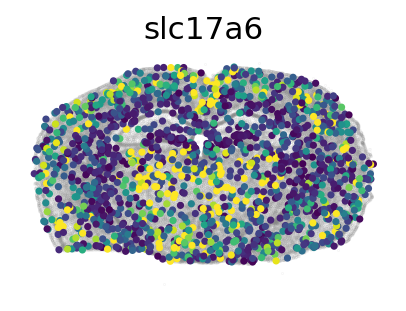

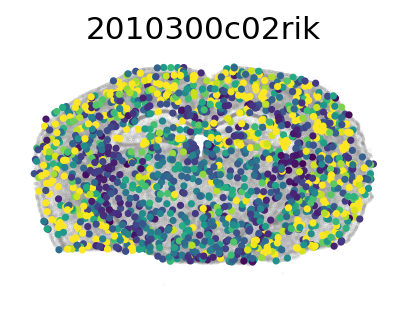

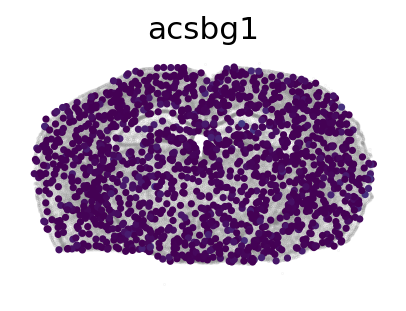

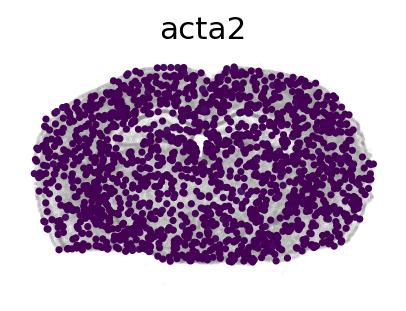

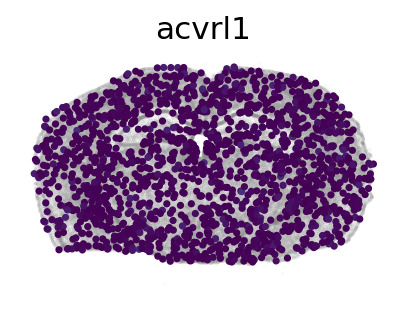

...

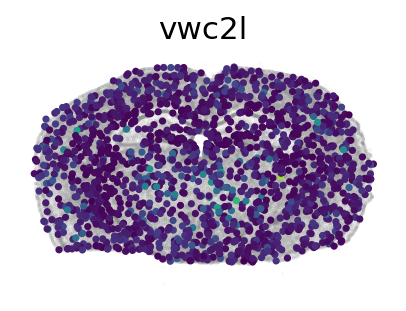

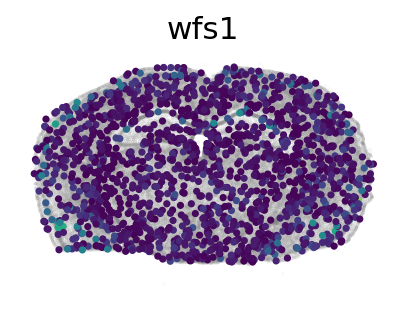

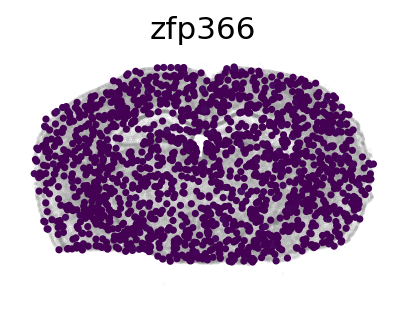

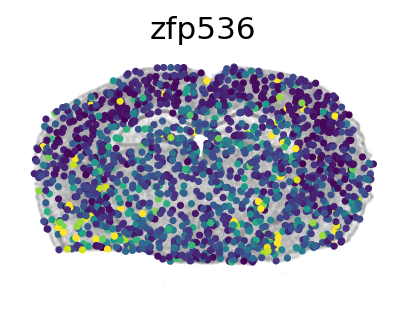

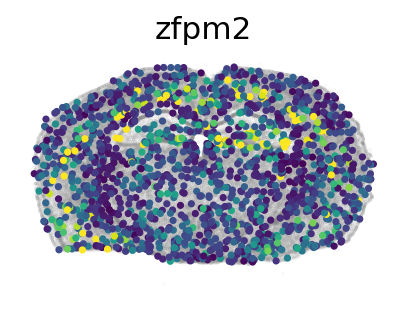

In [234]:
for g in preds.columns:

    plt.figure(figsize=(3,2))
    plt.scatter(adata.obs['x_centroid'],adata.obs['y_centroid'],c='grey',s=0.0007)
    plt.scatter(x=locations.X,y=locations.Y,c=preds[g],s=5,vmax=5)
    plt.axis('off')
    plt.title(g)
    plt.show()

(-304.3494622802734, 10370.918761596678, -291.4975530052185, 7222.40212491989)

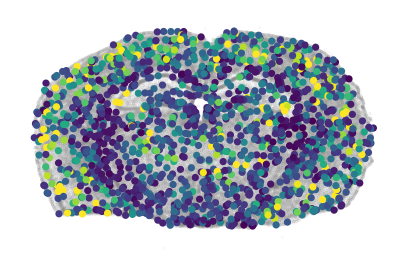

# Linear model

In [28]:
X=np.array(adatapred.obs.loc[:,['total_counts',
       'cell_area', 'nucleus_area','nucleus_prop',  'neighborhood_diversity',
       'neighborhood_density']])
Y=np.array(adatapred.obs.loc[:,['imputation_error']])

In [29]:
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, random_state=42)

# Create and train the linear regression model
model = LinearRegression()
model.fit(X_train, y_train)

# Make predictions on the test set
y_pred = model.predict(X_test)

# Evaluate the model's performance
mse = mean_squared_error(y_test, y_pred)
print(f"Mean Squared Error: {mse}")

Mean Squared Error: 0.043275946610691576


In [30]:
import pandas as pd
import statsmodels.api as sm
from statsmodels.formula.api import ols

In [31]:
adatapred

View of AnnData object with n_obs × n_vars = 1464 × 248
    obs: 'cell_id', 'x_centroid', 'y_centroid', 'transcript_counts', 'control_probe_counts', 'control_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'replicate', 'n_counts', 'n_genes', 'leiden_2_2', 'leiden_1_4', 'leiden_0_6', 'X', 'Y', 'X_umap', 'Y_umap', 'dataset_source', 'nucleus_prop', 'Class', 'neighborhood_diversity', 'neighborhood_density', 'negative_purity_ratio', 'negative_purity_values', 'negative_purity_potential', 'imputation_error'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'Class_colors', 'dendrogram_leiden_1_4', 'hvg', 'leiden', 'leiden_1_4_colors', 'leiden_2_2_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups', 'replicate_colors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'raw'
    obsp: 'connectivities', 'distances'

In [32]:
formula = 'imputation_error ~ Class + negative_purity_ratio + total_counts + neighborhood_density + neighborhood_diversity'

# Fit the ANOVA model
model = ols(formula, data=adatapred.obs).fit()

# Perform ANOVA
anova_table = sm.stats.anova_lm(model, typ=2)

# Print the ANOVA table to see the effects of each variable
print(anova_table)

                           sum_sq      df         F    PR(>F)
Class                    1.662500    39.0  0.938062  0.580351
negative_purity_ratio    0.006186     1.0  0.136116  0.712228
total_counts             0.012406     1.0  0.272993  0.601413
neighborhood_density     0.021431     1.0  0.471606  0.492361
neighborhood_diversity   0.004174     1.0  0.091859  0.761871
Residual                64.528847  1420.0       NaN       NaN


# Gene_basis

In [28]:
allsc=[]
for self in imputation_files:
    preds=pd.read_csv(path+'SpatialBenchmarking/XeniumResults/'+self,index_col=0)
    preds.columns=[c.lower() for c in preds.columns]
    preds=preds.loc[:,count.columns]
    #diff=abs(preds-count)
    #diff.index=adatasub.obs['cell_id']
    #resu=pd.DataFrame(np.mean(diff,axis=0),columns=[self.strip('_impute.csv')])
    #resu=resu.div(list(np.sum(count,axis=0)),axis=0)
    aggcor=[]
    for col in preds.columns:
        aggcor.append(np.corrcoef(preds.loc[:,col],count.loc[:,col])[0,1])
    resu=pd.DataFrame(aggcor,index=preds.columns,columns=[self.strip('_impute.csv')])
    allsc.append(resu)
    allsc.append(resu)
predict_score=pd.concat(allsc,axis=1)
predict_score['MEAN']=predict_score.mean(axis=1)
predict_score=predict_score.sort_values(by='MEAN')

/home/sergio/anaconda3/envs/xb/lib/python3.7/site-packages/numpy/lib/function_base.py:2691: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[:, None]
/home/sergio/anaconda3/envs/xb/lib/python3.7/site-packages/numpy/lib/function_base.py:2692: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[None, :]


In [265]:
predict_score

,gimVI,LIGER,novoSpaR,Seura,SpaGE,SpaOT,Tangra,MEAN
0,0.312916,0.072412,0.158277,0.339572,0.459245,0.212464,0.249110,0.257714
1,-0.017808,0.021999,-0.050528,0.478341,-0.004857,0.675969,0.012151,0.159324
2,0.653492,0.640054,0.539983,0.680538,0.712377,0.694990,0.623798,0.649319
3,0.315564,0.466985,0.334741,0.529669,0.563335,0.331999,0.324356,0.409521
4,0.561634,0.667247,0.540896,0.791376,0.777795,0.799665,0.702608,0.691603
...,...,...,...,...,...,...,...,...
1615,0.310581,0.477685,0.328292,0.376607,0.474638,0.632770,0.356871,0.422492
1616,0.290707,0.414371,0.352473,0.276375,0.384526,0.387289,0.263578,0.338474
1617,0.425800,0.487651,0.171683,0.466364,0.219590,0.553458,0.336106,0.380093
1618,-0.013122,0.094570,0.018119,0.525441,0.060456,0.057972,0.079862,0.117614


In [143]:
predict_score_sub=pd.concat([predict_score.iloc[:10,:],predict_score.iloc[-10:,:]],axis=0)

In [144]:
gene_errors_to_plot=predict_score_sub.stack().reset_index()
gene_errors_to_plot.columns=['gene','algorithm','imputation_error']

In [145]:
dicol={'gimVI':'#e1d649', 'novoSpaR':'#6e92d3', 'Seura':'#9d94bc',
 'SpaGE':'#e1d649', 'SpaOT':'#81c77c', 'Tangra':'#eab2c9', 'MEAN':'#a9b4b7','LIGER':'#8bcae1'}

In [146]:
gene_errors_to_plot['color']=gene_errors_to_plot['algorithm'].map(dicol)

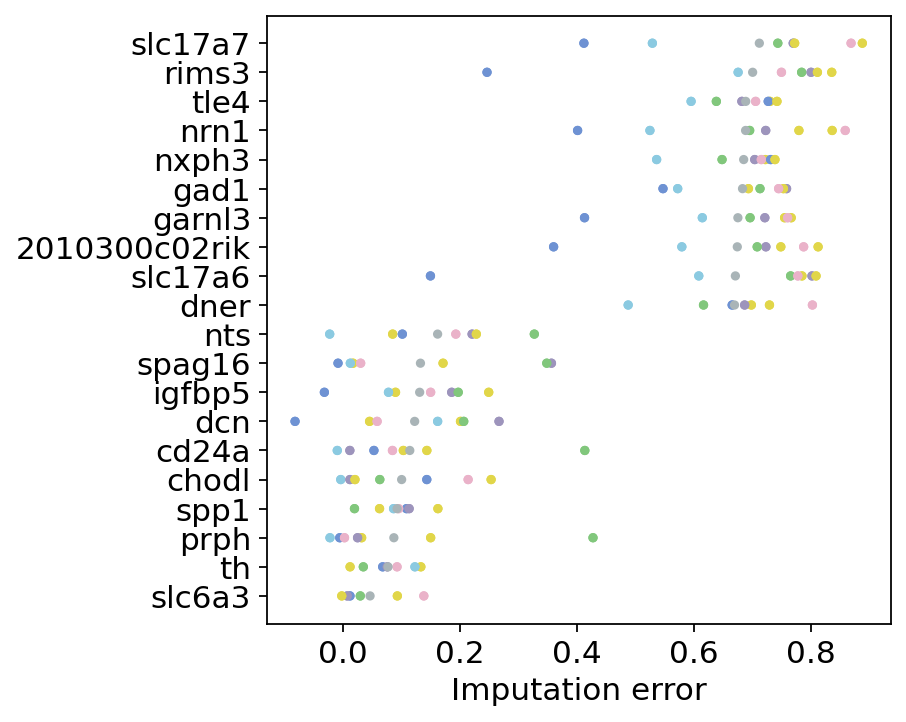

In [147]:
plt.figure(figsize=(5,5))
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
plt.scatter(y=gene_errors_to_plot['gene'],x=gene_errors_to_plot['imputation_error'],c=gene_errors_to_plot['color'],s=10)
plt. grid(False)
plt.xlabel('Imputation error')
plt.savefig('../../figures/6.Imputation/gene_specific_error_imputation_scatter.pdf')

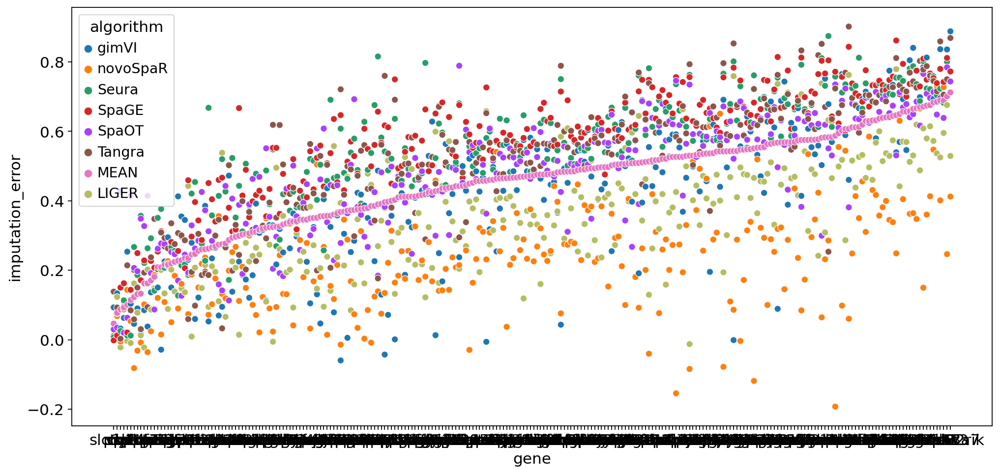

In [106]:
sns.scatterplot(data=gene_errors_to_plot,x='gene',y='imputation_error',hue='algorithm')
plt. grid(False)


In [29]:
predictability_score=dict(zip(predict_score.index,predict_score['MEAN']))

In [30]:
adatapred.var['error_score']=adatapred.var.index.map(predictability_score)

/home/sergio/anaconda3/envs/xb/lib/python3.7/site-packages/ipykernel_launcher.py:1: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  """Entry point for launching an IPython kernel.


Correlation is :0.577054464952264


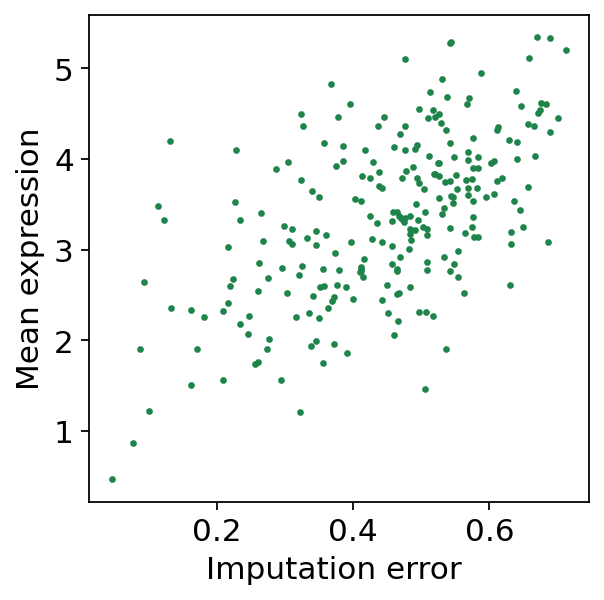

In [95]:
plt.figure(figsize=(4,4))
plt.scatter(adatapred.var['error_score'],adatapred.var['means'],s=4,c='#1E8449')
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
plt.ylabel('Mean expression')
plt.xlabel('Imputation error ')
plt. grid(False)
print('Correlation is :'+str(np.corrcoef(adatapred.var['error_score'],adatapred.var['means'])[0,1]))
plt.savefig('../../figures/6.Imputation/error_mean expression.pdf')

Correlation is :-0.16898620807865436


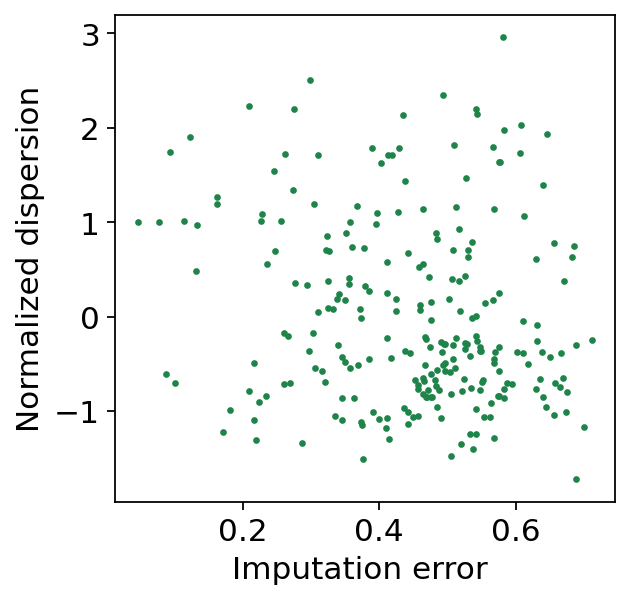

In [151]:
plt.figure(figsize=(4,4))
plt.scatter(adatapred.var['error_score'],adatapred.var['dispersions_norm'],s=4,c='#1E8449')
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
plt.ylabel('Normalized dispersion')
plt.xlabel('Imputation error ')
plt. grid(False)
print('Correlation is :'+str(np.corrcoef(adatapred.var['error_score'],adatapred.var['dispersions_norm'])[0,1]))
plt.savefig('../../figures/6.Imputation/error_normalized_dispersion.pdf')

# Correlation with other genes

In [36]:
expre=pd.DataFrame(adatapred.raw.X,columns=adatapred.var.index)

In [37]:
corro=pd.DataFrame(index=expre.columns,columns=expre.columns)
for col1 in expre.columns:
    for col2 in expre.columns:
        corro.loc[col1,col2]=np.corrcoef(expre.loc[:,col1],expre.loc[:,col2])[0,1]
for col1 in expre.columns:
    corro.loc[col1,col1]=0

In [38]:
maxcor=dict(zip(corro.index,np.max(abs(corro),axis=1)))
adatapred.var['maxcorr']=adatapred.var.index.map(maxcor)

In [39]:
meancor=dict(zip(corro.index,np.mean(abs(corro),axis=1)))
adatapred.var['meancorr']=adatapred.var.index.map(meancor)

Correlation is :0.28474853232856734


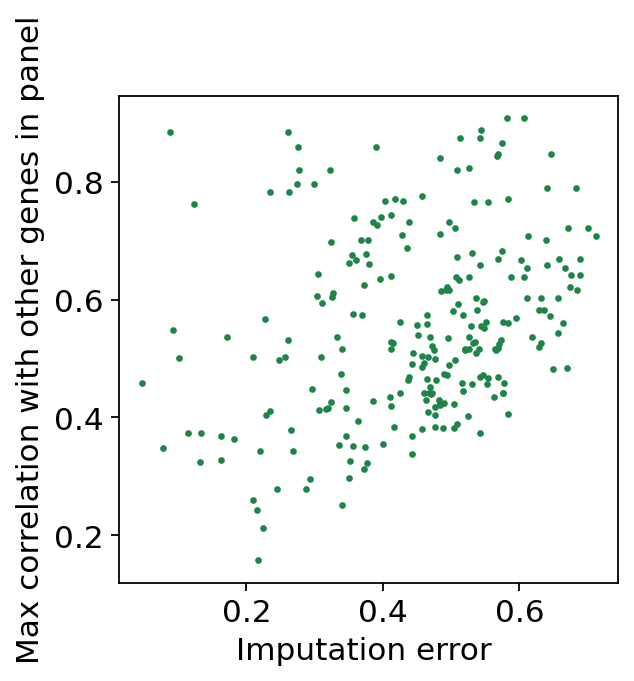

In [150]:
plt.figure(figsize=(4,4))
plt.scatter(adatapred.var['error_score'],adatapred.var['maxcorr'],s=4,c='#1E8449')
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
plt.ylabel('Max correlation with other genes in panel')
plt.xlabel('Imputation error ')
plt. grid(False)
print('Correlation is :'+str(np.corrcoef(adatapred.var['error_score'],adatapred.var['maxcorr'])[0,1]))
plt.savefig('../../figures/6.Imputation/error_max_correlation_with_other_genes.pdf')


Correlation is :0.7006368517851858


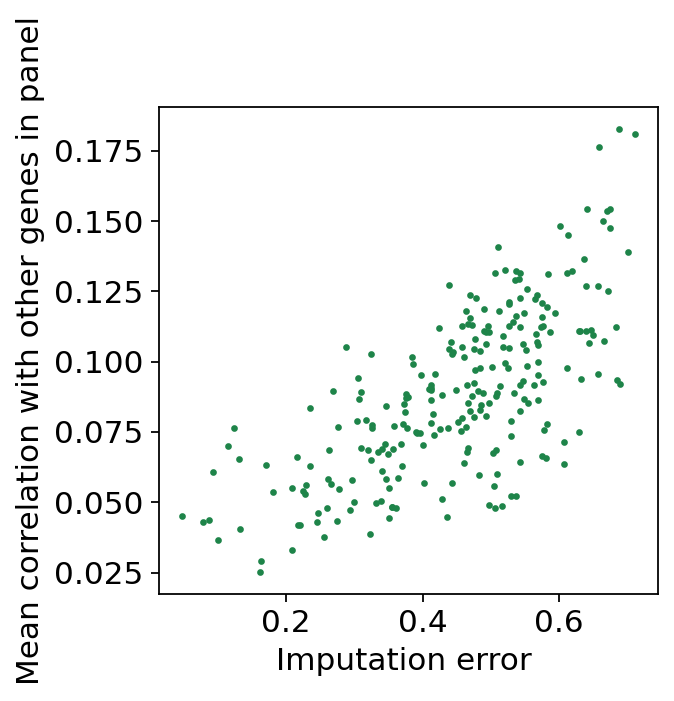

In [149]:
plt.figure(figsize=(4,4))
plt.scatter(adatapred.var['error_score'],adatapred.var['meancorr'],s=4,c='#1E8449')
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
plt.ylabel('Mean correlation with other genes in panel')
plt.xlabel('Imputation error ')
plt. grid(False)
print('Correlation is :'+str(np.corrcoef(adatapred.var['error_score'],adatapred.var['meancorr'])[0,1]))
plt.savefig('../../figures/6.Imputation/error_mean_correlation_with_other_genes.pdf')


# Subcellular position

In [51]:
geneinfo=pd.read_csv('../../figures/6.Imputation/GenePrediction/gene_information_distance_from_nuclei_multisection_1.csv')

In [52]:
genedic=dict(zip(geneinfo.iloc[:,0],geneinfo.loc[:,'distance']))
overlapsdic=dict(zip(geneinfo.iloc[:,0],geneinfo.loc[:,'overlaps_nucleus']))

In [53]:
adatapred.var['mean_dist_to_centroid']=adatapred.var.index.map(genedic)
adatapred.var['overlaps_nucleus']=adatapred.var.index.map(overlapsdic)

Correlation is :-0.011920599102395107


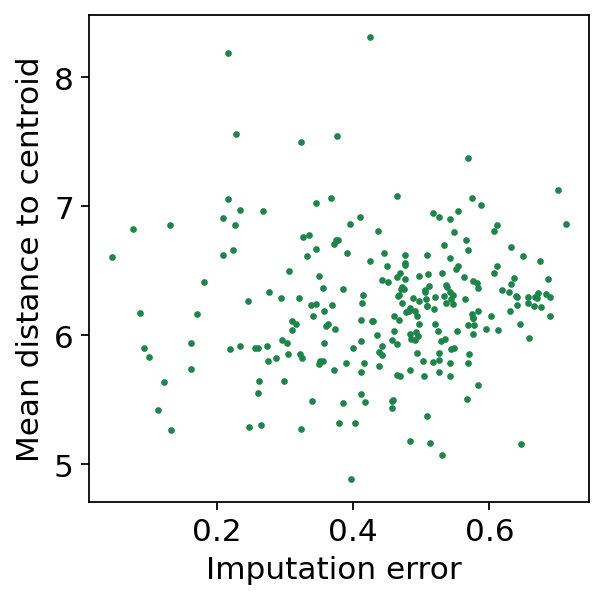

In [88]:
plt.figure(figsize=(4,4))
plt.scatter(adatapred.var['error_score'],adatapred.var['mean_dist_to_centroid'],s=4,c='#1E8449')
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
plt.ylabel('Mean distance to centroid')
plt.xlabel('Imputation error ')
plt. grid(False)
print('Correlation is :'+str(np.corrcoef(adatapred.var['error_score'],adatapred.var['overlaps_nucleus'])[0,1]))
plt.savefig('../../figures/6.Imputation/error_mean_distance_to_centroid.pdf')


Correlation is :-0.011920599102395107


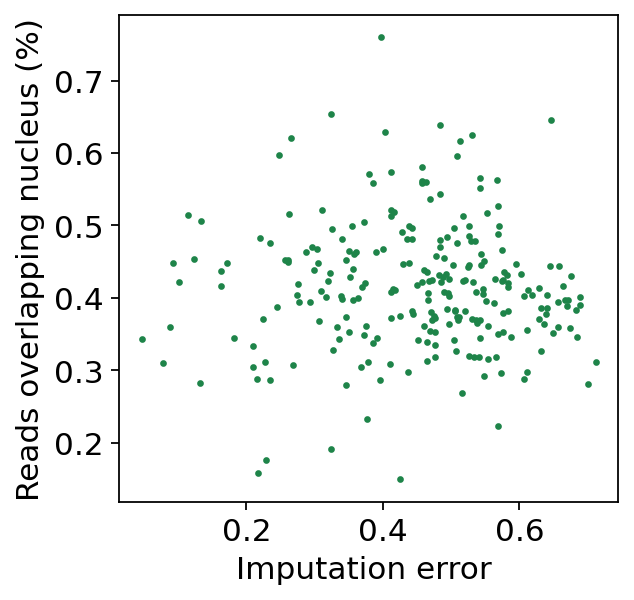

In [87]:
plt.figure(figsize=(4,4))
plt.scatter(adatapred.var['error_score'],adatapred.var['overlaps_nucleus'],s=4,c='#1E8449')
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
plt.ylabel('Reads overlapping nucleus (%)')
plt.xlabel('Imputation error ')
plt. grid(False)
print('Correlation is :'+str(np.corrcoef(adatapred.var['error_score'],adatapred.var['overlaps_nucleus'])[0,1]))
plt.savefig('../../figures/6.Imputation/error_overlaps nucleus.pdf')

In [60]:
adatapred.var.columns

Index(['highly_variable', 'means', 'dispersions', 'dispersions_norm',
       'error_score', 'maxcorr', 'meancorr', 'mean_dist_to_centroid',
       'overlaps_nucleus'],
      dtype='object')

In [186]:
np.max(X,axis=0)

array([1., 1., 1., 1., 1., 1.])

In [191]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error

# Load your dataset
data = adatapred.var

# Split the data into independent variables (X) and the dependent variable (y)
selected=['means', 'dispersions_norm',
    'maxcorr', 'meancorr', 'mean_dist_to_centroid',
       'overlaps_nucleus']
X = data[selected]
import sklearn.preprocessing as pp
scaler=pp.MinMaxScaler()
scaler.fit(X)
X=scaler.transform(X)

y = data['error_score']

# Split the data into a training set and a testing set
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Create and train a linear regression model
model = LinearRegression()
model.fit(X_train, y_train)

# Make predictions on the test set
y_pred = model.predict(X_test)

# Evaluate the model
mse = mean_squared_error(y_test, y_pred)
print(f'Mean Squared Error: {mse}')

# Interpret the model (e.g., inspect coefficients)
coefficients = model.coef_
intercept = model.intercept_
print('Coefficients:', coefficients)
print('Intercept:', intercept)


Mean Squared Error: 0.007366914721426971
Coefficients: [ 0.1272812  -0.03951656  0.11778749  0.41657456  0.15339683  0.11900955]
Intercept: 0.04562348168400093


In [188]:
coef=pd.DataFrame(coefficients,index=selected,columns=['coefficients'])
coef=coef.sort_values(by='coefficients')

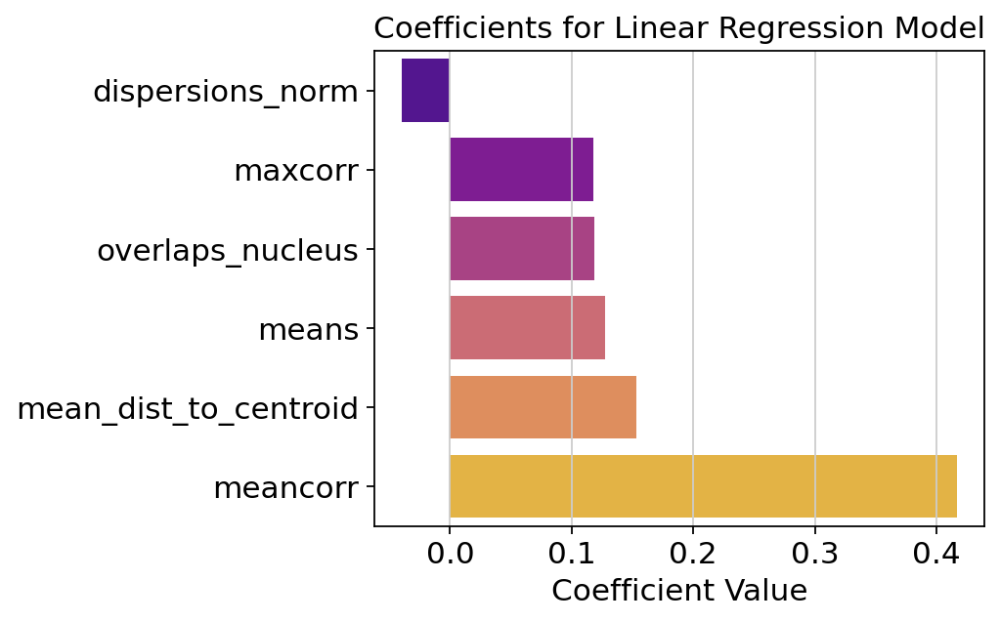

In [189]:
import seaborn as sns
plt.figure(figsize=(5, 4))
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
sns.barplot(y=coef.index,x=coef['coefficients'],palette='plasma')
plt.xlabel('Coefficient Value')
plt.title('Coefficients for Linear Regression Model')
plt.savefig('../../figures/6.Imputation/regression_gene_coefficient_parameters_imputation.pdf')

In [99]:
formula = 'error_score ~ means + dispersions_norm + maxcorr+ meancorr'

# Fit the ANOVA model
model = ols(formula, data=adatapred.var).fit()

# Perform ANOVA
anova_table = sm.stats.anova_lm(model, typ=2)

# Print the ANOVA table to see the effects of each variable
print(anova_table)

                    sum_sq     df          F        PR(>F)
means             0.064723    1.0   6.996999  8.697022e-03
dispersions_norm  0.018622    1.0   2.013171  1.572204e-01
maxcorr           0.152644    1.0  16.501770  6.562561e-05
meancorr          0.571028    1.0  61.731713  1.270113e-13
Residual          2.247789  243.0        NaN           NaN
